<img src="https://www.hi-paris.fr/wp-content/uploads/2020/09/logo-hi-paris-retina.png" alt="Yolo" width="250"/>

# **Fire Detection**


22 / 09 / 2024



By: **Aissa** ABDELAZIZ



# Objectif 🎯
The aim of this project is to develop a model capable of detecting fire-related objects in images captured by surveillance towers located in the forest. This solution will assist French firefighters in enhancing forest protection and improving early fire detection efforts.

# Import Libraries

In [ ]:
#Install some packages
!pip install ultralytics mlflow pyngrok

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import yaml
import locale
from google.colab import drive
from ultralytics import settings
import mlflow
from ultralytics import YOLO, solutions
from pyngrok import ngrok
from IPython.display import Image
import cv2
from google.colab.patches import cv2_imshow

# Visualize the Dataset.

In [ ]:
locale.getpreferredencoding = lambda: "UTF-8"

In [ ]:
#import google drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#unzip the dataset and update the paths in "data.yamml"
!unzip /content/drive/MyDrive/data_fire.zip

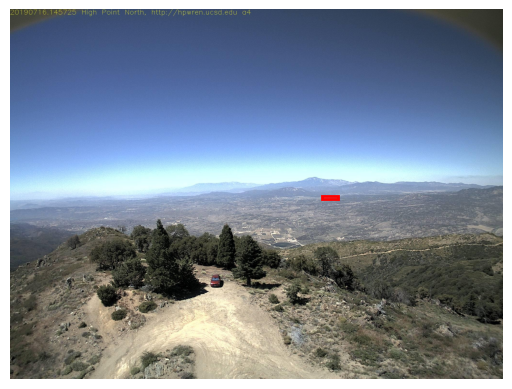

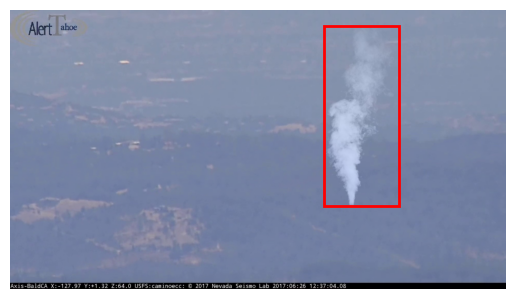

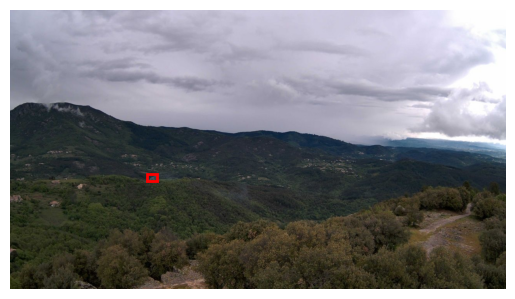

In [ ]:
from PIL import Image
#open "data.ymal"
data_yaml_path = '/content/DS-71c1fd51-v2/data.yaml'
with open(data_yaml_path, 'r') as file:
    data_config = yaml.safe_load(file)

train_image_dir = data_config['train']
label_dir = train_image_dir.replace('images', 'labels')

#Display an image with bounding boxes
def visualize_yolo_bboxes(img_path, label_path):
    image = Image.open(img_path)
    img_width, img_height = image.size
    fig, ax = plt.subplots(1)
    ax.imshow(image)


    with open(label_path, 'r') as file:
        for line in file.readlines():
            class_id, x_center, y_center, width, height = map(float, line.strip().split())
            x_center *= img_width
            y_center *= img_height
            width *= img_width
            height *= img_height
            x_min = x_center - width / 2
            y_min = y_center - height / 2
            rect = patches.Rectangle((x_min, y_min), width, height, linewidth=2, edgecolor='r', facecolor='none')
            ax.add_patch(rect)

    # Display the image with bounding boxes
    plt.axis('off')
    plt.show()

# Visualize some images
image_files = os.listdir(train_image_dir)

for img_file in image_files[2:6]:
    img_path = os.path.join(train_image_dir, img_file)
    label_path = os.path.join(label_dir, img_file.replace('.jpg', '.txt'))

    if os.path.exists(label_path):
        visualize_yolo_bboxes(img_path, label_path)


# **Yolo Models**


---

**YOLO** (You Only Look Once) is a widely used set of object detection models known for their ability to perform real-time object detection and classification in computer vision tasks.

The primary advantage of YOLO is its single-stage detection approach, which is designed for real-time object detection with high accuracy. YOLO analyzes the entire image in one pass, significantly enhancing its speed and efficiency. This makes it particularly suitable for applications that require rapid processing.

Since its inception, several versions of YOLO (see image below) have been released, each improving upon the previous iterations by introducing advancements in accuracy, speed, and model architecture. These improvements have enabled YOLO to maintain its relevance and effectiveness in various applications, continually setting benchmarks in the field of object detection.

---




<img src="https://miro.medium.com/v2/resize:fit:1400/format:webp/0*AHhonCLpqIAEhMvf" alt="Yolo" width="800"/>



# **YoloV8 Model**

<img src="https://miro.medium.com/v2/resize:fit:1400/format:webp/0*V-lR1emDSCLeo5y-" alt="Yolov8 architecture" width="800"/>

In [ ]:
#install ultralytics library
!pip install ultralytics mlflow

In [ ]:
# Update a setting
settings.update({"mlflow": True})

# Reset settings to default values
settings.reset()

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# Train Yolov8

In [ ]:
data_yaml_path = '/content/DS-71c1fd51-v2/data.yaml'
model_weights = 'yolov8n.pt'  # Other Options: 'yolov8n.pt', 'yolov8s.pt', etc.

mlflow.set_experiment('YOLOv8-FireDetection')

# Train YOLOv8
with mlflow.start_run(run_name='YOLOv8-Fire-Detection'):
    # Initialize YOLOv8 model
    model = YOLO(model_weights)

    # Log hyperparameters to MLflow
    mlflow.log_param('model_weights', model_weights)
    mlflow.log_param('data_yaml', data_yaml_path)

    # Train the model
    results = model.train(
        data=data_yaml_path,
        epochs=50,
        imgsz=640,
        batch=16,
        name='yolov8_fire',
        augment=True,  # Enable data augmentation
    )

    # Log training metrics to MLflow
    training_metrics = results.results_dict
    mlflow.log_metric('mAP50', training_metrics['metrics/mAP50(B)'])  # mAP@50
    mlflow.log_metric('mAP50-95', training_metrics['metrics/mAP50-95(B)'])  # mAP@50-95
    mlflow.log_metric('precision', training_metrics['metrics/precision(B)'])  # Precision
    mlflow.log_metric('recall', training_metrics['metrics/recall(B)'])  # Recall

    # Validate the model
    validation_results = model.val(data=data_yaml_path)
    validation_metrics = validation_results.results_dict

    # Log validation metrics to MLflow
    mlflow.log_metric('val/mAP50', validation_metrics['metrics/mAP50(B)'])  # mAP@50
    mlflow.log_metric('val/mAP50-95', validation_metrics['metrics/mAP50-95(B)'])  # mAP@50-95
    mlflow.log_metric('val/precision', validation_metrics['metrics/precision(B)'])  # Precision
    mlflow.log_metric('val/recall', validation_metrics['metrics/recall(B)'])  # Recall

print("Training and validation complete, and metrics logged to MLflow.")


2024/09/22 20:49:44 INFO mlflow.tracking.fluent: Experiment with name 'YOLOv8-FireDetection' does not exist. Creating a new experiment.


Ultralytics YOLOv8.2.99 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/DS-71c1fd51-v2/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8_fire2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_con

/usr/local/lib/python3.10/dist-packages/ultralytics/utils/torch_utils.py:254: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/torch_utils.py:259: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operati

AMP: checks passed ✅


train: Scanning /content/DS-71c1fd51-v2/labels/train.cache... 6053 images, 650 backgrounds, 0 corrupt: 100%|██████████| 6703/6703 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/DS-71c1fd51-v2/labels/val.cache... 1529 images, 170 backgrounds, 0 corrupt: 100%|██████████| 1699/1699 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov8_fire2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)


2024/09/22 20:49:52 WARNING mlflow.utils.autologging_utils: MLflow statsmodels autologging is known to be compatible with 0.11.1 <= statsmodels <= 0.14.2, but the installed version is 0.14.3. If you encounter errors during autologging, try upgrading / downgrading statsmodels to a compatible version, or try upgrading MLflow.
2024/09/22 20:49:52 INFO mlflow.tracking.fluent: Autologging successfully enabled for statsmodels.
2024/09/22 20:49:52 INFO mlflow.tracking.fluent: Autologging successfully enabled for keras.
2024/09/22 20:49:52 INFO mlflow.tracking.fluent: Autologging successfully enabled for tensorflow.


MLflow: logging run_id(4a22cf79818b4f9aab9590a7d19a23f6) to runs/mlflow
MLflow: view at http://127.0.0.1:5000 with 'mlflow server --backend-store-uri runs/mlflow'
MLflow: disable with 'yolo settings mlflow=False'
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov8_fire2
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       1/50      8.14G      1.712      2.891      1.487         22        640: 100%|██████████| 419/419 [03:08<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540       0.42      0.334      0.321      0.152

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       2/50      2.86G      1.832      2.048      1.576         29        640: 100%|██████████| 419/419 [02:59<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.495      0.319      0.328      0.153

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       3/50      2.86G      1.839       1.91      1.561         19        640: 100%|██████████| 419/419 [03:02<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.379      0.264      0.257      0.137

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       4/50      2.85G      1.788       1.79       1.53         28        640: 100%|██████████| 419/419 [03:08<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.383      0.246      0.222      0.103

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       5/50      2.85G      1.741      1.707      1.493         24        640: 100%|██████████| 419/419 [03:05<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540       0.52      0.424      0.407      0.201

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       6/50      2.85G      1.666      1.625       1.44         24        640: 100%|██████████| 419/419 [03:03<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.528      0.429      0.444      0.237

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       7/50      2.85G      1.612      1.562      1.423         22        640: 100%|██████████| 419/419 [03:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.307      0.338      0.242      0.127

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       8/50      2.84G      1.603      1.522      1.418         25        640: 100%|██████████| 419/419 [03:01<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540       0.47      0.334      0.358      0.183

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
       9/50      2.85G      1.589      1.509      1.401         22        640: 100%|██████████| 419/419 [03:01<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.568      0.458      0.472      0.253

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      10/50      2.85G      1.543      1.455      1.371         27        640: 100%|██████████| 419/419 [03:04<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.538      0.316      0.351      0.181



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      11/50      2.84G      1.515      1.392      1.358         29        640: 100%|██████████| 419/419 [03:02<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.601      0.462      0.509      0.272



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      12/50      2.84G      1.511      1.378       1.35         27        640: 100%|██████████| 419/419 [03:01<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.626      0.525      0.564      0.309



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      13/50      2.85G      1.475      1.329      1.328         26        640: 100%|██████████| 419/419 [03:02<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.637      0.494      0.545      0.312

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      14/50      2.85G       1.48      1.359      1.333         32        640: 100%|██████████| 419/419 [03:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.621       0.49      0.535      0.297

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      15/50      2.84G      1.453      1.319      1.328         24        640: 100%|██████████| 419/419 [03:02<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.614       0.49      0.525      0.301

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      16/50      2.84G      1.458      1.293      1.316         23        640: 100%|██████████| 419/419 [03:01<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.686      0.505      0.578      0.319

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      17/50      2.85G      1.435      1.281      1.308         26        640: 100%|██████████| 419/419 [03:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.596        0.5      0.526      0.296

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      18/50      2.85G      1.408      1.245      1.298         22        640: 100%|██████████| 419/419 [03:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.646      0.494      0.549      0.317

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      19/50      2.84G      1.407      1.239      1.294         27        640: 100%|██████████| 419/419 [03:41<00:00,  1.90it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.658      0.534      0.584      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      20/50      2.84G      1.396      1.215      1.284         26        640: 100%|██████████| 419/419 [03:29<00:00,  2.00it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540       0.63        0.5      0.537       0.31



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      21/50      2.85G      1.378      1.192      1.279         26        640: 100%|██████████| 419/419 [03:30<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.607      0.509      0.546      0.311

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      22/50      2.85G      1.359      1.182      1.266         23        640: 100%|██████████| 419/419 [03:23<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.675      0.527      0.591      0.343

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      23/50      2.84G      1.344      1.152      1.258         18        640: 100%|██████████| 419/419 [03:19<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.653      0.496      0.571      0.333

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      24/50      2.84G      1.338      1.156      1.253         26        640: 100%|██████████| 419/419 [03:21<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.681      0.569      0.605      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      25/50      2.85G      1.336      1.136      1.259         32        640: 100%|██████████| 419/419 [03:01<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.665      0.506      0.577      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      26/50      2.85G      1.319      1.136      1.241         33        640: 100%|██████████| 419/419 [03:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.652      0.516      0.571       0.33



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      27/50      2.84G      1.325      1.113      1.238         27        640: 100%|██████████| 419/419 [03:05<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.694      0.559      0.616      0.365



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      28/50      2.84G      1.311       1.09      1.237         28        640: 100%|██████████| 419/419 [03:01<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.693      0.561      0.607      0.362



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      29/50      2.85G      1.287      1.084      1.225         33        640: 100%|██████████| 419/419 [03:02<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540       0.71      0.528      0.607      0.355

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      30/50      2.85G      1.291      1.078      1.229         20        640: 100%|██████████| 419/419 [03:01<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.688      0.525      0.599      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      31/50      2.84G      1.283      1.069      1.225         16        640: 100%|██████████| 419/419 [03:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.684       0.56      0.616       0.36



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      32/50      2.84G       1.27      1.056       1.21         29        640: 100%|██████████| 419/419 [03:03<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.714       0.57      0.629      0.371



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      33/50      2.85G      1.251      1.033      1.203         26        640: 100%|██████████| 419/419 [03:01<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.699       0.54      0.624       0.38



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      34/50      2.85G      1.239      1.006      1.203         23        640: 100%|██████████| 419/419 [03:03<00:00,  2.29it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.732      0.534      0.617      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      35/50      2.84G      1.225     0.9988      1.199         19        640: 100%|██████████| 419/419 [03:04<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.726      0.559      0.635      0.373

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      36/50      2.84G      1.214      0.992      1.196         16        640: 100%|██████████| 419/419 [03:03<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.739      0.552      0.624      0.382

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      37/50      2.85G      1.216     0.9695      1.183         26        640: 100%|██████████| 419/419 [03:02<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.694      0.587      0.631      0.383

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      38/50      2.85G      1.197     0.9631      1.182         24        640: 100%|██████████| 419/419 [03:04<00:00,  2.27it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.736      0.529      0.614      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      39/50      2.84G      1.198     0.9487      1.187         22        640: 100%|██████████| 419/419 [03:01<00:00,  2.30it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.733      0.541      0.631      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      40/50      2.84G      1.197     0.9464      1.171         33        640: 100%|██████████| 419/419 [03:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.716       0.55      0.633      0.386


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      41/50      2.85G      1.203      0.886      1.157         12        640: 100%|██████████| 419/419 [03:00<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.714      0.572      0.641      0.395



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      42/50      2.85G      1.163     0.8468       1.14         12        640: 100%|██████████| 419/419 [02:55<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.715      0.549      0.626      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      43/50      2.84G       1.16     0.8469      1.131         15        640: 100%|██████████| 419/419 [02:56<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540       0.71      0.552      0.624      0.386



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      44/50      2.84G      1.141     0.8333       1.12         13        640: 100%|██████████| 419/419 [02:55<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.697      0.558      0.636      0.393

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      45/50      2.85G      1.133     0.8172      1.121         10        640: 100%|██████████| 419/419 [02:51<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.711      0.561      0.634      0.393

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      46/50      2.85G      1.121     0.8064      1.119         14        640: 100%|██████████| 419/419 [02:53<00:00,  2.42it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.733      0.539      0.627      0.392

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      47/50      2.84G       1.11     0.7922      1.106         16        640: 100%|██████████| 419/419 [02:55<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.725      0.568      0.643        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      48/50      2.85G      1.104     0.7915      1.105         14        640: 100%|██████████| 419/419 [02:56<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.715      0.567      0.632      0.397

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      49/50      2.85G      1.092     0.7771      1.102         15        640: 100%|██████████| 419/419 [02:56<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540      0.728      0.559       0.64        0.4



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


  0%|          | 0/419 [00:00<?, ?it/s]/usr/local/lib/python3.10/dist-packages/ultralytics/utils/loss.py:202: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  pred_dist = pred_dist.view(b, a, 4, c // 4).softmax(3).matmul(self.proj.type(pred_dist.dtype))
      50/50      2.85G      1.071      0.765      1.087         13        640: 100%|██████████| 419/419 [02:59<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R   

                   all       1699       1540       0.72      0.566      0.642      0.402



50 epochs completed in 2.936 hours.
Optimizer stripped from runs/detect/yolov8_fire2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/yolov8_fire2/weights/best.pt, 6.2MB

Validating runs/detect/yolov8_fire2/weights/best.pt...
Ultralytics YOLOv8.2.99 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


/usr/local/lib/python3.10/dist-packages/ultralytics/utils/torch_utils.py:254: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/torch_utils.py:259: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operati

                   all       1699       1540      0.713       0.55      0.637      0.401
Speed: 0.2ms preprocess, 5.2ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/yolov8_fire2
MLflow: results logged to runs/mlflow
MLflow: disable with 'yolo settings mlflow=False'
Ultralytics YOLOv8.2.99 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


/usr/local/lib/python3.10/dist-packages/ultralytics/utils/torch_utils.py:254: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operation is not deterministic because it uses CuBLAS and you have CUDA >= 10.2. To enable deterministic behavior in this case, you must set an environment variable before running your PyTorch application: CUBLAS_WORKSPACE_CONFIG=:4096:8 or CUBLAS_WORKSPACE_CONFIG=:16:8. For more information, go to https://docs.nvidia.com/cuda/cublas/index.html#results-reproducibility (Triggered internally at ../aten/src/ATen/Context.cpp:185.)
  fusedconv.weight.copy_(torch.mm(w_bn, w_conv).view(fusedconv.weight.shape))
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/torch_utils.py:259: UserWarning: Deterministic behavior was enabled with either `torch.use_deterministic_algorithms(True)` or `at::Context::setDeterministicAlgorithms(true)`, but this operati

                   all       1699       1540      0.708       0.55      0.636      0.402
Speed: 0.2ms preprocess, 8.4ms inference, 0.0ms loss, 1.4ms postprocess per image
Results saved to runs/detect/yolov8_fire22
Training and validation complete, and metrics logged to MLflow.


# Result

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/runs

<IPython.core.display.Javascript object>

In [ ]:
!mlflow server --backend-store-uri runs/mlflow --port 5004 &

[2024-09-22 10:10:48 +0000] [22640] [INFO] Starting gunicorn 23.0.0
[2024-09-22 10:10:48 +0000] [22640] [INFO] Listening at: http://127.0.0.1:5002 (22640)
[2024-09-22 10:10:48 +0000] [22640] [INFO] Using worker: sync
[2024-09-22 10:10:48 +0000] [22645] [INFO] Booting worker with pid: 22645
[2024-09-22 10:10:48 +0000] [22646] [INFO] Booting worker with pid: 22646
[2024-09-22 10:10:48 +0000] [22647] [INFO] Booting worker with pid: 22647
[2024-09-22 10:10:48 +0000] [22648] [INFO] Booting worker with pid: 22648
[2024-09-22 10:11:23 +0000] [22640] [INFO] Handling signal: int
[2024-09-22 10:11:23 +0000] [22645] [INFO] Worker exiting (pid: 22645)
[2024-09-22 10:11:23 +0000] [22647] [INFO] Worker exiting (pid: 22647)
[2024-09-22 10:11:23 +0000] [22646] [INFO] Worker exiting (pid: 22646)
[2024-09-22 10:11:23 +0000] [22648] [INFO] Worker exiting (pid: 22648)
[2024-09-22 10:11:23 +0000] [22640] [INFO] Shutting down: Master


In [ ]:
ngrok.set_auth_token('2mQCtz2BOdkdPugYNjo48xCAu20_W4xNB92MzPKzjzCgL7zo')

# Start ngrok
public_url = ngrok.connect(5005)
print("MLflow server is running at:", public_url)

In [ ]:
#Losses
Image(filename=f'/content/runs/detect/yolov8_fire2/results.png', width=600)

# Validation  

In [ ]:
model = YOLO('/content/best.pt')  #we select the best model parameters


In [ ]:
#model = YOLO('/content/runs/detect/yolov8_fire2/weights/best.pt')  #we select the best model parameters
metrics = model.val(data='/content/DS-71c1fd51-v2/data.yaml', imgsz=640, batch=16)

Ultralytics YOLOv8.2.99 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,005,843 parameters, 0 gradients, 8.1 GFLOPs


100%|██████████| 755k/755k [00:00<00:00, 15.2MB/s]
val: Scanning /content/DS-71c1fd51-v2/labels/val... 1529 images, 170 backgrounds, 0 corrupt: 100%|██████████| 1699/1699 [00:01<00:00, 1244.10it/s]


val: New cache created: /content/DS-71c1fd51-v2/labels/val.cache


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 107/107 [00:29<00:00,  3.63it/s]


                   all       1699       1540      0.736      0.572      0.646        0.4
Speed: 0.4ms preprocess, 3.2ms inference, 0.0ms loss, 2.1ms postprocess per image
Results saved to runs/detect/val


In [ ]:
#print the result of the evaluation metrics on val dataset
print(metrics.results_dict)

{'metrics/precision(B)': 0.7363966602116656, 'metrics/recall(B)': 0.5720779220779221, 'metrics/mAP50(B)': 0.6461986262843997, 'metrics/mAP50-95(B)': 0.40005610428699256, 'fitness': 0.4246703564867333}


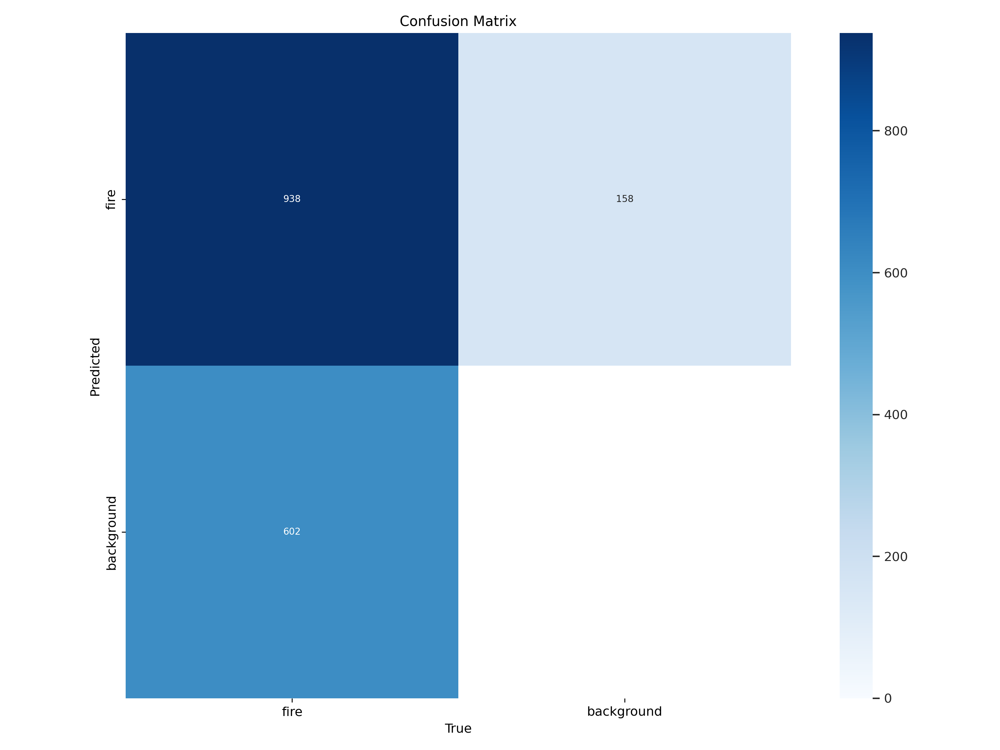

In [ ]:
#Confusion Matrix
Image(filename=f'/content/runs/detect/yolov8_fire2/confusion_matrix.png', width=600)

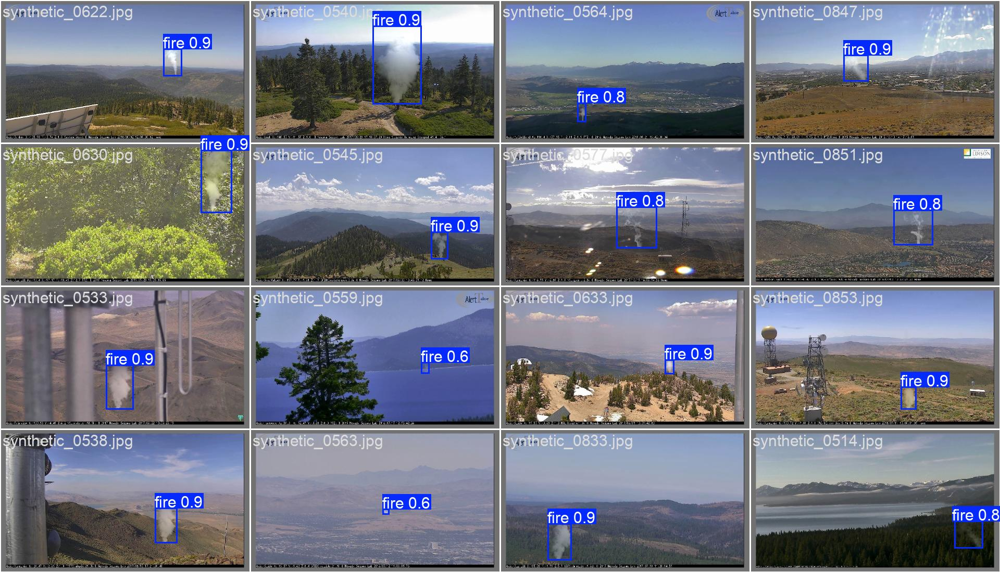

In [ ]:
#Model Prediction on validaiton images
Image(filename=f'/content/runs/detect/yolov8_fire2/val_batch1_pred.jpg', width=600)


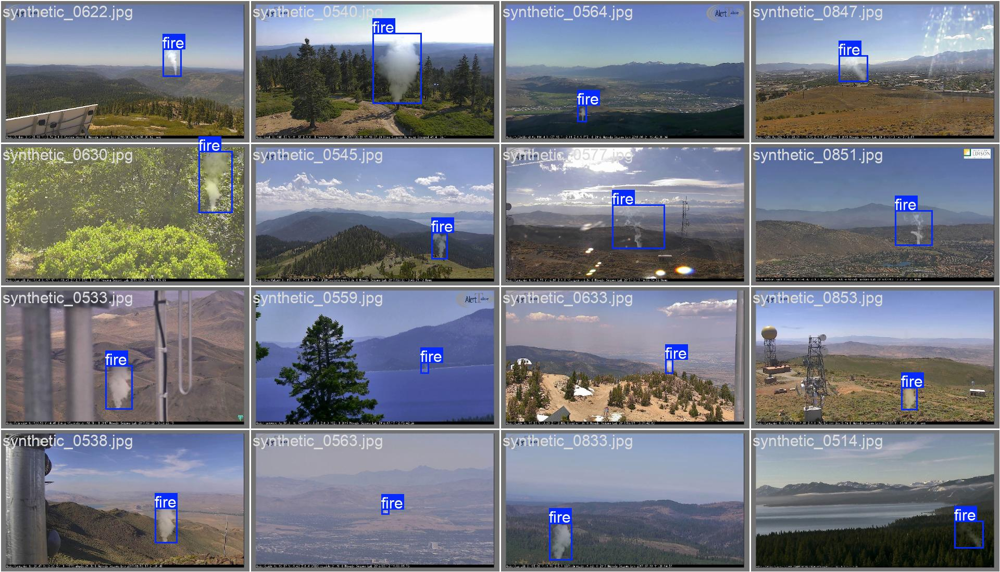

In [ ]:
#Labels (Ground truth) of the validaiton images
Image(filename=f'/content/runs/detect/yolov8_fire2/val_batch1_labels.jpg', width=600)


# Display the heatmap

WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()

None

0: 480x640 1 fire, 19.1ms
Speed: 2.0ms preprocess, 19.1ms inference, 3.0ms postprocess per image at shape (1, 3, 480, 640)


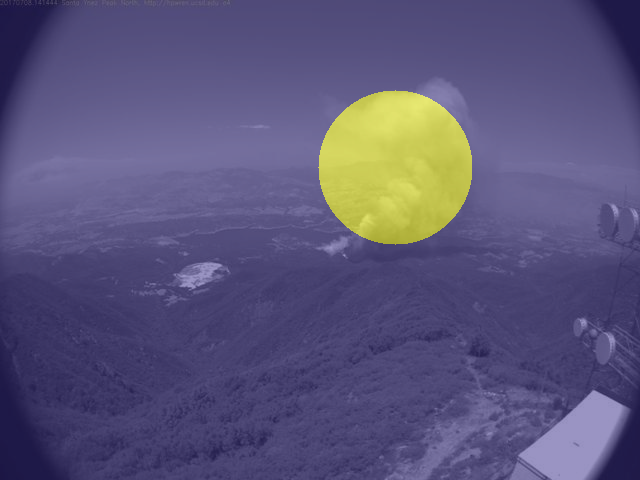

In [ ]:
#Image path
image_path = "/content/DS-71c1fd51-v2/images/val/aiformankind_v1_000678.jpg"

im0 = cv2.imread(image_path)

# Generate heatmap
heatmap_obj = solutions.Heatmap(colormap=cv2.COLORMAP_PARULA, view_img=True, shape="circle", names=model.names)
tracks = model.track(im0, persist=True, show=False)
im0 = heatmap_obj.generate_heatmap(im0, tracks)
cv2_imshow(im0)

WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()

None

0: 480x640 1 fire, 28.5ms
Speed: 2.4ms preprocess, 28.5ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


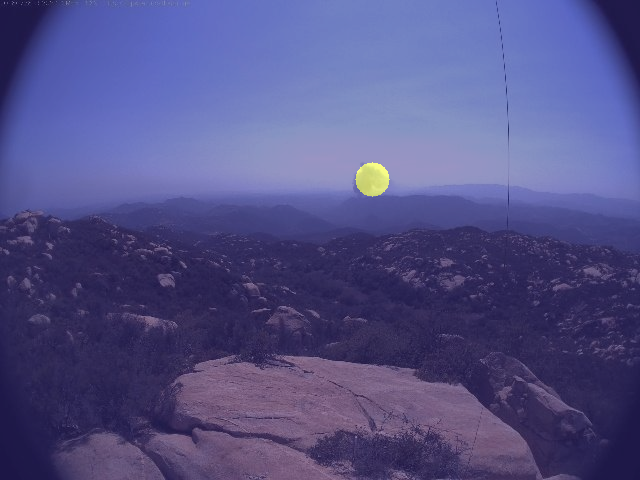

In [ ]:
#Image path
image_path = "/content/DS-71c1fd51-v2/images/val/aiformankind_v2_002142.jpg"

im0 = cv2.imread(image_path)

# Generate heatmap
heatmap_obj = solutions.Heatmap(colormap=cv2.COLORMAP_PARULA, view_img=True, shape="circle", names=model.names)
tracks = model.track(im0, persist=True, show=False)
im0 = heatmap_obj.generate_heatmap(im0, tracks)
cv2_imshow(im0)

# **Yolov5 Model**

<img src="https://miro.medium.com/v2/resize:fit:1400/format:webp/1*FeAAyTPI4Uz0gJ3jOZ6jBw.png" alt="Yolov8 architecture" width="800"/>

In [ ]:
data_yaml_path = '/content/DS-71c1fd51-v2/data.yaml'
model_weights = 'yolov5n.pt'  # Options: 'yolov5n.pt', 'yolov5s.pt', etc.

mlflow.set_experiment('YOLOv5-FireDetection')

# Train YOLOv5
with mlflow.start_run(run_name='YOLOv5-Fire-Detection'):
    model = YOLO(model_weights)

    # Log hyperparameters to MLflow
    mlflow.log_param('model_weights', model_weights)
    mlflow.log_param('data_yaml', data_yaml_path)

    # Train the model
    results = model.train(
        data=data_yaml_path,
        epochs=50,
        imgsz=640,
        batch=16,
        name='yolov5_fire',
        augment=True,  # Enable data augmentation
    )

    # Log training metrics to MLflow
    training_metrics = results.results_dict
    mlflow.log_metric('mAP50', training_metrics['metrics/mAP50'])  # mAP@50
    mlflow.log_metric('mAP50-95', training_metrics['metrics/mAP50-95'])  # mAP@50-95
    mlflow.log_metric('precision', training_metrics['metrics/precision'])  # Precision
    mlflow.log_metric('recall', training_metrics['metrics/recall'])  # Recall

    # Validate the model
    validation_results = model.val(data=data_yaml_path)
    validation_metrics = validation_results.results_dict

    # Log validation metrics to MLflow
    mlflow.log_metric('val/mAP50', validation_metrics['metrics/mAP50'])  # mAP@50
    mlflow.log_metric('val/mAP50-95', validation_metrics['metrics/mAP50-95'])  # mAP@50-95
    mlflow.log_metric('val/precision', validation_metrics['metrics/precision'])  # Precision
    mlflow.log_metric('val/recall', validation_metrics['metrics/recall'])  # Recall

print("Training and validation complete, and metrics logged to MLflow.")


2024/09/22 14:21:54 INFO mlflow.tracking.fluent: Experiment with name 'YOLOv5-FireDetection' does not exist. Creating a new experiment.


PRO TIP 💡 Replace 'model=yolov5n.pt' with new 'model=yolov5nu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



100%|██████████| 5.31M/5.31M [00:00<00:00, 123MB/s]

Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)


engine/trainer: task=detect, mode=train, model=yolov5n.pt, data=/content/DS-71c1fd51-v2/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov5_fire, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=True, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, line_width=None, format=torchscript, keras=False, optimize=Fals

train: Scanning /content/DS-71c1fd51-v2/labels/train.cache... 6053 images, 650 backgrounds, 0 corrupt: 100%|██████████| 6703/6703 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/DS-71c1fd51-v2/labels/val.cache... 1529 images, 170 backgrounds, 0 corrupt: 100%|██████████| 1699/1699 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov5_fire/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 69 weight(decay=0.0), 76 weight(decay=0.0005), 75 bias(decay=0.0)


2024/09/22 14:22:46 INFO mlflow.tracking.fluent: Autologging successfully enabled for keras.
2024/09/22 14:22:46 WARNING mlflow.utils.autologging_utils: MLflow statsmodels autologging is known to be compatible with 0.11.1 <= statsmodels <= 0.14.2, but the installed version is 0.14.3. If you encounter errors during autologging, try upgrading / downgrading statsmodels to a compatible version, or try upgrading MLflow.
2024/09/22 14:22:46 INFO mlflow.tracking.fluent: Autologging successfully enabled for statsmodels.
2024/09/22 14:22:46 INFO mlflow.tracking.fluent: Autologging successfully enabled for tensorflow.


MLflow: logging run_id(c0c4f4b362e7414d8c4d1911a3968c45) to runs/mlflow
MLflow: view at http://127.0.0.1:5000 with 'mlflow server --backend-store-uri runs/mlflow'
MLflow: disable with 'yolo settings mlflow=False'
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov5_fire
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50       2.4G      1.713      2.951      1.479         22        640: 100%|██████████| 419/419 [03:22<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.97it/s]


                   all       1699       1540      0.343       0.37      0.293       0.13

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      2.26G      1.843      2.071       1.54         29        640: 100%|██████████| 419/419 [03:22<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.05it/s]


                   all       1699       1540      0.399      0.274      0.259      0.127

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      2.31G      1.857      1.921      1.543         19        640: 100%|██████████| 419/419 [03:15<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.99it/s]


                   all       1699       1540      0.518      0.377      0.383      0.187

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      2.27G      1.816      1.832       1.52         28        640: 100%|██████████| 419/419 [03:20<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:24<00:00,  2.17it/s]


                   all       1699       1540      0.377      0.283      0.257      0.128

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      2.27G       1.76      1.756      1.485         24        640: 100%|██████████| 419/419 [03:16<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.99it/s]


                   all       1699       1540      0.466      0.308      0.315      0.162

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      2.26G      1.699      1.673      1.439         24        640: 100%|██████████| 419/419 [03:15<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:25<00:00,  2.12it/s]


                   all       1699       1540      0.546      0.417      0.438      0.215

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      2.26G      1.669      1.605      1.423         22        640: 100%|██████████| 419/419 [03:16<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.01it/s]


                   all       1699       1540      0.522      0.386      0.408      0.212

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      2.32G      1.632       1.55        1.4         25        640: 100%|██████████| 419/419 [03:18<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.05it/s]


                   all       1699       1540       0.53      0.457      0.455      0.245

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      2.27G      1.627      1.523      1.386         22        640: 100%|██████████| 419/419 [03:15<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:25<00:00,  2.09it/s]


                   all       1699       1540      0.527      0.451      0.475      0.245

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      2.26G      1.587      1.497       1.37         27        640: 100%|██████████| 419/419 [03:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.97it/s]


                   all       1699       1540      0.607      0.469      0.504      0.277

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      2.26G      1.551      1.428      1.347         29        640: 100%|██████████| 419/419 [03:16<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.99it/s]


                   all       1699       1540       0.59      0.433      0.482       0.25

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      2.32G      1.543      1.416      1.346         27        640: 100%|██████████| 419/419 [03:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:25<00:00,  2.10it/s]


                   all       1699       1540      0.628      0.356      0.418      0.218

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      2.27G      1.513      1.373      1.325         26        640: 100%|██████████| 419/419 [03:22<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.96it/s]


                   all       1699       1540      0.616      0.516      0.551      0.309

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      2.26G      1.516        1.4      1.332         32        640: 100%|██████████| 419/419 [03:21<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.99it/s]

                   all       1699       1540      0.483      0.336       0.34      0.174



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      2.26G      1.484      1.369      1.322         24        640: 100%|██████████| 419/419 [03:27<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.00it/s]


                   all       1699       1540      0.585      0.475      0.505      0.289

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      2.32G      1.474      1.338      1.301         23        640: 100%|██████████| 419/419 [03:26<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:28<00:00,  1.92it/s]


                   all       1699       1540      0.609      0.397      0.463      0.257

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      2.27G      1.491      1.346      1.319         26        640: 100%|██████████| 419/419 [03:31<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.99it/s]


                   all       1699       1540      0.643      0.514      0.568      0.314

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      2.26G      1.457      1.301      1.301         22        640: 100%|██████████| 419/419 [03:23<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.97it/s]

                   all       1699       1540      0.618      0.505      0.557      0.315



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      2.26G      1.447      1.283      1.288         27        640: 100%|██████████| 419/419 [03:27<00:00,  2.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.04it/s]


                   all       1699       1540      0.617      0.501      0.563      0.323

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      2.32G      1.436      1.254      1.271         26        640: 100%|██████████| 419/419 [03:22<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.02it/s]


                   all       1699       1540      0.636      0.484      0.552      0.313

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      2.27G       1.42      1.238      1.277         26        640: 100%|██████████| 419/419 [03:39<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.98it/s]


                   all       1699       1540      0.694      0.491      0.583      0.333

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      2.26G      1.407       1.22      1.259         23        640: 100%|██████████| 419/419 [03:25<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.99it/s]


                   all       1699       1540      0.607      0.529      0.572      0.321

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      2.26G      1.385      1.198      1.261         18        640: 100%|██████████| 419/419 [03:19<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.95it/s]


                   all       1699       1540      0.628      0.529      0.578      0.332

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      2.32G      1.382      1.186      1.249         26        640: 100%|██████████| 419/419 [03:26<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.03it/s]


                   all       1699       1540       0.68      0.537      0.607      0.341

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      2.27G       1.38      1.191      1.262         32        640: 100%|██████████| 419/419 [03:15<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.96it/s]

                   all       1699       1540      0.694      0.543      0.605      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      2.26G      1.353      1.167      1.242         33        640: 100%|██████████| 419/419 [03:22<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.98it/s]


                   all       1699       1540      0.688      0.499      0.581       0.34

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      2.26G      1.357      1.151      1.237         27        640: 100%|██████████| 419/419 [03:19<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.05it/s]

                   all       1699       1540      0.665      0.512      0.592      0.349



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      2.32G      1.345      1.142      1.235         28        640: 100%|██████████| 419/419 [03:16<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.06it/s]


                   all       1699       1540      0.676      0.492      0.572      0.338

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      2.27G      1.321       1.13      1.221         33        640: 100%|██████████| 419/419 [03:21<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:25<00:00,  2.11it/s]


                   all       1699       1540      0.634      0.477      0.554      0.314

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      2.26G      1.341      1.123      1.233         20        640: 100%|██████████| 419/419 [03:17<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.01it/s]


                   all       1699       1540      0.652      0.525      0.594      0.349

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      2.26G      1.316      1.109      1.216         16        640: 100%|██████████| 419/419 [03:17<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:25<00:00,  2.10it/s]

                   all       1699       1540      0.696      0.535      0.611      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      2.32G      1.302      1.097      1.201         29        640: 100%|██████████| 419/419 [03:20<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.00it/s]

                   all       1699       1540      0.692      0.544      0.622      0.369



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      2.27G      1.286      1.068      1.196         26        640: 100%|██████████| 419/419 [03:20<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.99it/s]

                   all       1699       1540       0.71      0.526      0.612      0.361



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      2.26G      1.281      1.055      1.199         23        640: 100%|██████████| 419/419 [03:22<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:25<00:00,  2.11it/s]

                   all       1699       1540      0.728      0.533      0.627      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      2.26G      1.254      1.036      1.188         19        640: 100%|██████████| 419/419 [03:17<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:25<00:00,  2.09it/s]

                   all       1699       1540      0.686       0.56      0.639      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      2.32G      1.243      1.027      1.185         16        640: 100%|██████████| 419/419 [03:17<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.06it/s]

                   all       1699       1540      0.714      0.559      0.636      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      2.27G       1.25       1.01      1.185         26        640: 100%|██████████| 419/419 [03:20<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.02it/s]


                   all       1699       1540      0.695       0.57      0.628      0.377

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      2.26G      1.238      1.005      1.178         24        640: 100%|██████████| 419/419 [03:15<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.00it/s]

                   all       1699       1540      0.679      0.545      0.616      0.375



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      2.26G      1.223     0.9895      1.179         22        640: 100%|██████████| 419/419 [03:17<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.03it/s]


                   all       1699       1540      0.709      0.552       0.63      0.378

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      2.32G      1.235     0.9822      1.169         33        640: 100%|██████████| 419/419 [03:20<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:25<00:00,  2.09it/s]


                   all       1699       1540      0.696      0.564      0.639      0.382
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      2.27G      1.232     0.9408       1.16         12        640: 100%|██████████| 419/419 [03:13<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.04it/s]

                   all       1699       1540      0.726      0.536      0.622      0.374



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      2.26G      1.205     0.9019      1.148         12        640: 100%|██████████| 419/419 [03:10<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:25<00:00,  2.13it/s]

                   all       1699       1540      0.695      0.574      0.639      0.382



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      2.26G      1.197     0.8824      1.139         15        640: 100%|██████████| 419/419 [03:11<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:25<00:00,  2.10it/s]


                   all       1699       1540      0.705      0.575      0.649      0.388

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      2.32G      1.185     0.8807      1.127         13        640: 100%|██████████| 419/419 [03:18<00:00,  2.11it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.95it/s]

                   all       1699       1540      0.713      0.582      0.651      0.399



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      2.27G      1.169     0.8633      1.124         10        640: 100%|██████████| 419/419 [03:17<00:00,  2.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.02it/s]

                   all       1699       1540      0.695      0.593      0.652      0.394



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      2.26G      1.176      0.854      1.128         14        640: 100%|██████████| 419/419 [03:12<00:00,  2.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.02it/s]

                   all       1699       1540      0.704      0.578      0.651      0.393



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      2.26G      1.151     0.8408      1.109         16        640: 100%|██████████| 419/419 [03:17<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.01it/s]

                   all       1699       1540      0.724       0.55      0.635      0.387



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      2.32G      1.143     0.8327      1.108         14        640: 100%|██████████| 419/419 [03:15<00:00,  2.15it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:25<00:00,  2.08it/s]

                   all       1699       1540      0.718      0.566      0.651      0.392



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      2.27G      1.141     0.8217      1.112         15        640: 100%|██████████| 419/419 [03:12<00:00,  2.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:26<00:00,  2.03it/s]

                   all       1699       1540      0.716      0.562      0.652      0.398



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      2.26G      1.119     0.7997      1.094         13        640: 100%|██████████| 419/419 [03:15<00:00,  2.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:27<00:00,  1.96it/s]

                   all       1699       1540      0.715      0.564       0.65      0.395



50 epochs completed in 3.176 hours.
Optimizer stripped from runs/detect/yolov5_fire/weights/last.pt, 5.3MB
Optimizer stripped from runs/detect/yolov5_fire/weights/best.pt, 5.3MB

Validating runs/detect/yolov5_fire/weights/best.pt...
Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv5n summary (fused): 193 layers, 2,503,139 parameters, 0 gradients, 7.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 54/54 [00:28<00:00,  1.87it/s]


                   all       1699       1540       0.71      0.565      0.642        0.4
Speed: 0.2ms preprocess, 4.9ms inference, 0.0ms loss, 1.9ms postprocess per image
Results saved to runs/detect/yolov5_fire
MLflow: results logged to runs/mlflow
MLflow: disable with 'yolo settings mlflow=False'


KeyError: 'metrics/mAP50'

In [ ]:
%load_ext tensorboard
%tensorboard --logdir /content/runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 13814), started 3:36:15 ago. (Use '!kill 13814' to kill it.)

<IPython.core.display.Javascript object>

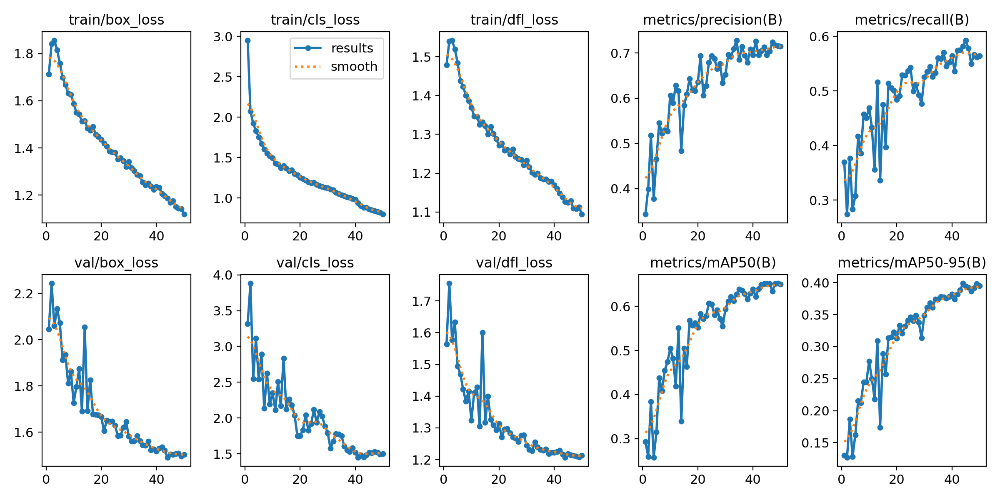

In [ ]:
# Display losses
Image(filename=f'/content/runs/detect/yolov5_fire/results.png', width=600)

# validation

In [ ]:
#Load the model with the best parameters
model = YOLO('/content/runs/detect/yolov5_fire/weights/best.pt')
#Run the evaluation
metrics = model.val(data='/content/DS-71c1fd51-v2/data.yaml', imgsz=640, batch=16)

Ultralytics YOLOv8.2.98 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv5n summary (fused): 193 layers, 2,503,139 parameters, 0 gradients, 7.1 GFLOPs


val: Scanning /content/DS-71c1fd51-v2/labels/val.cache... 1529 images, 170 backgrounds, 0 corrupt: 100%|██████████| 1699/1699 [00:00<?, ?it/s]
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 107/107 [00:31<00:00,  3.45it/s]


                   all       1699       1540      0.714      0.582      0.651      0.398
Speed: 0.3ms preprocess, 4.0ms inference, 0.0ms loss, 2.1ms postprocess per image
Results saved to runs/detect/val3


In [ ]:
#Print the evaluation metrics on validation set
print(metrics.results_dict)

{'metrics/precision(B)': 0.7140779153374224, 'metrics/recall(B)': 0.5821993567776149, 'metrics/mAP50(B)': 0.6513127031832414, 'metrics/mAP50-95(B)': 0.3977956047090208, 'fitness': 0.4231473145564429}


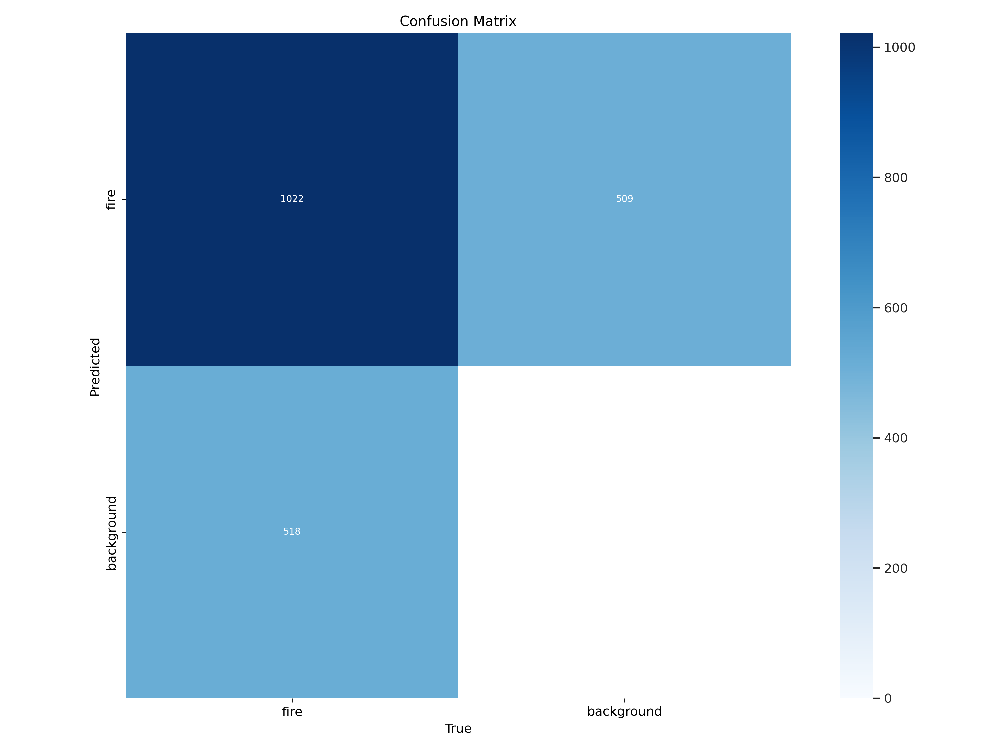

In [ ]:
#Display the confusion matrix
Image(filename=f'/content/runs/detect/yolov5_fire/confusion_matrix.png', width=600)

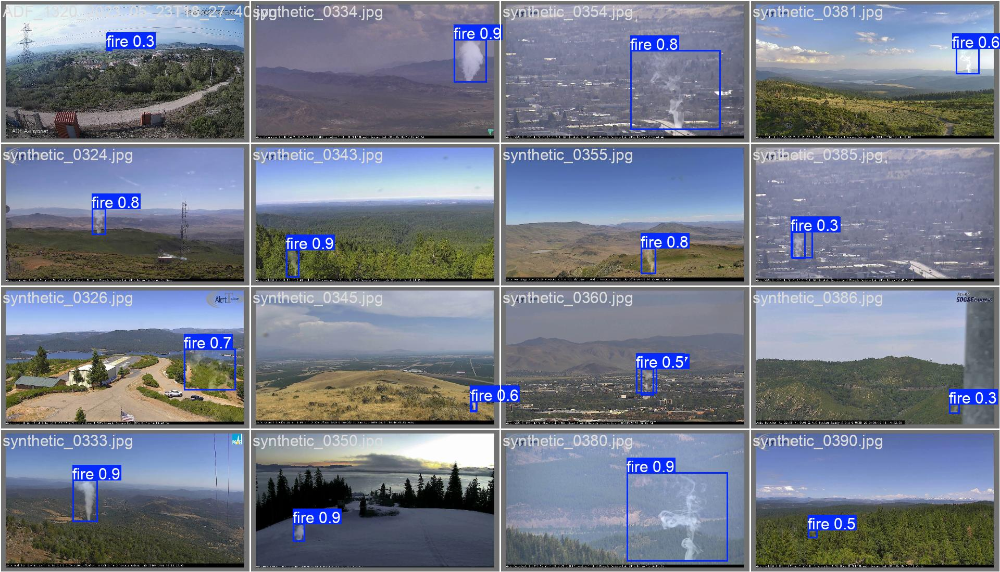

In [ ]:
#Display the predicted smoke on the validation set
Image(filename=f'/content/runs/detect/yolov5_fire/val_batch0_pred.jpg', width=600)

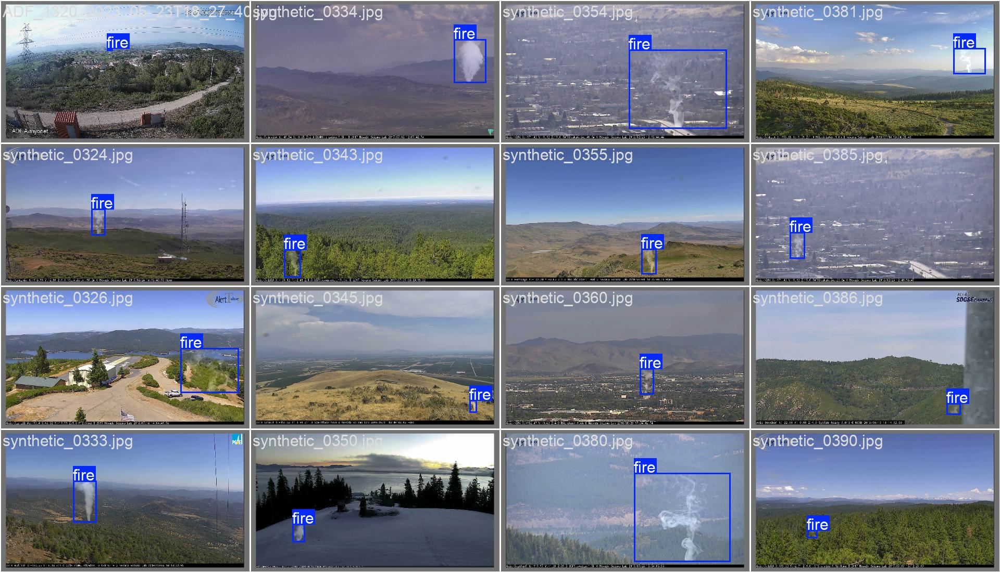

In [ ]:
#Display the ground truth of the validation set
Image(filename=f'/content/runs/detect/yolov5_fire/val_batch0_labels.jpg', width=600)

# Display Heatmap

WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()

None

0: 480x640 1 fire, 8.5ms
Speed: 1.9ms preprocess, 8.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 640)


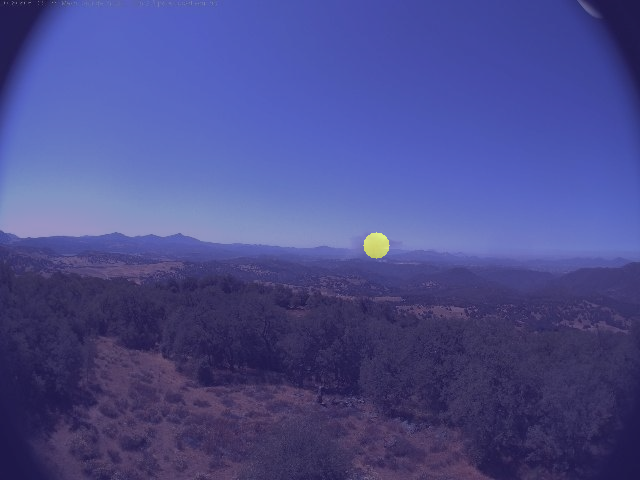

In [ ]:
#Image path
image_path = "/content/DS-71c1fd51-v2/images/val/aiformankind_v2_002101.jpg"

im0 = cv2.imread(image_path)

# Generate heatmap
heatmap_obj = solutions.Heatmap(colormap=cv2.COLORMAP_PARULA, view_img=True, shape="circle", names=model.names)
tracks = model.track(im0, persist=True, show=False)
im0 = heatmap_obj.generate_heatmap(im0, tracks)
cv2_imshow(im0)

#Results and Comparison

| Metrics              | YOLOv8               | YOLOv5               |
|----------------------|----------------------|----------------------|
| Precision (B)         | 0.7363966602116656   | 0.7140779153374224   |
| Recall (B)            | 0.5720779220779221   | 0.5821993567776149   |
| mAP50 (B)             | 0.6461986262843997   | 0.6513127031832414   |
| mAP50-95 (B)          | 0.40005610428699256  | 0.3977956047090208   |
| Fitness               | 0.4246703564867333   | 0.4231473145564429   |


`The comparison between YOLOv5 and YOLOv8 shows slight improvements in precision and overall performance for YOLOv8. YOLOv8 achieves higher precision (0.736) compared to YOLOv5 (0.714), though recall is slightly lower in YOLOv8. The mAP50 and mAP50-95 metrics are similar between both models, indicating comparable detection accuracy. YOLOv8 also slightly outperforms YOLOv5 in terms of fitness, making it a better model for object detection tasks.Overall, YOLOv8 performs better than YOLOv5.`